In [1]:
import igraph
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import math
import matplotlib.patches as mpatches
import matplotlib.pyplot as plt
import os
import pygraphviz
os.chdir("../src")
from build_network_object import build_network_object
from draw_network_by_classification import draw_network_by_classification, compare_degrees_strength
from draw_adjacency_matrix import draw_adjacency_matrix
from draw_and_print_communities import draw_and_print_communities, compare_comunity_intersection
from correlations import correlation_industry_pairs, correlation_network_degree,correlation_adjacency_matrix
from networkx_functions import build_networx_network
import seaborn as sns
import networkx as nx

In [2]:
label1 = "Table1_Reduced_matrix_2009_2018_flows"
reduced_matrix_2009_2018 = pd.read_csv("../data/"+label1+".csv", index_col=0)

reduced_matrix_2009_2018_flows = reduced_matrix_2009_2018[reduced_matrix_2009_2018['StartIndst']!=0]

sub_matrix_2009_2018_less1 = reduced_matrix_2009_2018_flows[reduced_matrix_2009_2018_flows['weight']<1].sort_values(by=['weight'], ascending=False)
sub_matrix_2009_2018_flows = sub_matrix_2009_2018_less1[sub_matrix_2009_2018_less1['weight']>0].sort_values(by=['weight'], ascending=False)

print ("Number of links:", sub_matrix_2009_2018_flows.shape[0]/2)
print ("Number of 4-digit industries observed:")
print (len(np.unique([sub_matrix_2009_2018_flows['StartIndst'].values,sub_matrix_2009_2018_flows['FinalIndst'].values])))
sub_matrix_2009_2018_flows[1:15]

Number of links: 1153.0
Number of 4-digit industries observed:
356


,StartIndst,FinalIndst,weight,SubActivity_StartIndst,SubActivity_FinalIndst,MainActivity_StartIndst,MainActivity_FinalIndst,MainIndustry_StartIndst,MainIndustry_FinalIndst,Counts
4302,4611,4623,0.999931,"Agriculture, animals, raw goods",Live animals,Fee/contract - wholesale,Agricultural wholesale,"Wholesale and retail,motor vehicle repair,sale...","Wholesale and retail,motor vehicle repair,sale...",10
4281,2732,2731,0.999828,"Other electronic, electric wires",Fibre optic cables,Electrical equipment,Electrical equipment,"Manufacture computer, electronic, light electr...","Manufacture computer, electronic, light electr...",10
4221,2731,2732,0.999821,Fibre optic cables,"Other electronic, electric wires",Electrical equipment,Electrical equipment,"Manufacture computer, electronic, light electr...","Manufacture computer, electronic, light electr...",11
4186,1813,1712,0.999697,"Pre-press, pre-media services","Paper, paperboard",Printing,Paper and paper products,All other Manufacturing,All other Manufacturing,10
4137,1712,1813,0.999649,"Paper, paperboard","Pre-press, pre-media services",Paper and paper products,Printing,All other Manufacturing,All other Manufacturing,18
3986,3040,3311,0.999642,Military fighting vehicles,Fabricated metal products,Other transport equipment,Repair/installation excl. household,"Manufacture machinery, vehicle, transport",Machinery repair excluding motor vehicles,10
4169,2899,2620,0.999599,Other,"Computers, peripheral equipment",Special purpose machinery,"Computer, electronic, optical","Manufacture machinery, vehicle, transport","Manufacture computer, electronic, light electr...",15
4218,2620,2899,0.999597,"Computers, peripheral equipment",Other,"Computer, electronic, optical",Special purpose machinery,"Manufacture computer, electronic, light electr...","Manufacture machinery, vehicle, transport",12
4276,2312,2311,0.999567,"Flat glass shaping, processing",Flat glass manufacture,Glass products,Glass products,All other Manufacturing,All other Manufacturing,10
4304,3311,3040,0.999539,Fabricated metal products,Military fighting vehicles,Repair/installation excl. household,Other transport equipment,Machinery repair excluding motor vehicles,"Manufacture machinery, vehicle, transport",25


In [3]:
label1 = "Node_list_SR_Sept_2019"
manchester_matrix_2009_2018 = pd.read_csv("../data/"+label1+".csv", index_col=0)

manchester_matrix_2009_2018['StartIndst'] = manchester_matrix_2009_2018.index

manchester_matrix_2009_2018.shape

manchester_matrix_2009_2018

,Label,community,employment_count,lq,lq_true,Eccentricity,closnesscentrality,harmonicclosnesscentrality,betweenesscentrality,Weighted Degree,StartIndst
Id,,,,,,,,,,,
161,Support crop prod,1.0,150.0,0.34,0.0,4,0.406948,0.436822,138.099369,3.9233,161
162,Support animal prod,1.0,150.0,0.49,0.0,4,0.405606,0.432080,91.750934,2.1555,162
170,Hunting,1.0,40.0,0.91,0.0,5,0.314578,0.326287,0.366970,0.7571,170
210,Siviculture,1.0,100.0,0.28,0.0,4,0.400651,0.427676,253.267011,3.3485,210
240,Forestry support,1.0,100.0,0.65,0.0,4,0.435013,0.468157,643.103700,4.8101,240
311,Marine fishing,3.0,10.0,0.06,0.0,5,0.326693,0.336958,2.064702,0.4221,311
899,Other mining,1.0,5.0,0.13,0.0,4,0.361499,0.379743,13.977132,1.4238,899
910,Petrol gas extraction support,6.0,40.0,0.05,0.0,4,0.454294,0.485264,215.440574,5.3110,910
1011,Meat processing,2.0,600.0,0.57,0.0,4,0.450549,0.481877,187.474053,3.5388,1011


In [4]:
result = pd.merge(manchester_matrix_2009_2018[['Label','StartIndst','employment_count','lq_true','lq']],sub_matrix_2009_2018_flows,on=['StartIndst'],how='outer')

result['LabelStartIndst'] = result['Label']
result['EmploymentCountStartIndst'] = result['employment_count']
result['LqStartIndst'] = result['lq_true']



result.drop(['Label','employment_count','lq_true'],axis=1,inplace=True)

result.head()

,StartIndst,lq,FinalIndst,weight,SubActivity_StartIndst,SubActivity_FinalIndst,MainActivity_StartIndst,MainActivity_FinalIndst,MainIndustry_StartIndst,MainIndustry_FinalIndst,Counts,LabelStartIndst,EmploymentCountStartIndst,LqStartIndst
0,161,0.34,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Support crop prod,150.0,0.0
1,162,0.49,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Support animal prod,150.0,0.0
2,170,0.91,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Hunting,40.0,0.0
3,210,0.28,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Siviculture,100.0,0.0
4,240,0.65,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Forestry support,100.0,0.0


In [5]:
manchester_matrix_2009_2018['FinalIndst'] = manchester_matrix_2009_2018.index

result_final = pd.merge(manchester_matrix_2009_2018[['Label','FinalIndst','employment_count','lq_true']],result,on=['FinalIndst'],how='outer')

result_final['LabelFinalIndst'] = result_final['Label']
result_final['EmploymentCountFinalIndst'] = result_final['employment_count']
result_final['LqFinalIndst'] = result_final['lq_true']


result_final.drop(['Label','employment_count','lq_true'],axis=1,inplace=True)


result_final.head()

,FinalIndst,StartIndst,lq,weight,SubActivity_StartIndst,SubActivity_FinalIndst,MainActivity_StartIndst,MainActivity_FinalIndst,MainIndustry_StartIndst,MainIndustry_FinalIndst,Counts,LabelStartIndst,EmploymentCountStartIndst,LqStartIndst,LabelFinalIndst,EmploymentCountFinalIndst,LqFinalIndst
0,161.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Support crop prod,150.0,0.0
1,162.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Support animal prod,150.0,0.0
2,170.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Hunting,40.0,0.0
3,210.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Siviculture,100.0,0.0
4,240.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Forestry support,100.0,0.0


In [6]:
result_final['isManchester'] = result_final['LqFinalIndst'] + result_final['LqStartIndst']

result_final_onlyMan = result_final[result_final['isManchester']==2]
result_final_notMan = result_final[result_final['isManchester']!=2]

In [7]:
network_largest_2009_2018_nx_manchester= build_networx_network(result_final_onlyMan,'weight')

network_largest_2008_2018_max_span_tree_manchester = nx.maximum_spanning_tree(network_largest_2009_2018_nx_manchester)
weights_manchester = [3*network_largest_2008_2018_max_span_tree_manchester[u][v]['weight'] for u,v in network_largest_2008_2018_max_span_tree_manchester.edges()]
color = ['red' for u,v in network_largest_2008_2018_max_span_tree_manchester.edges()]

network_largest_2008_2018_max_span_tree_manchester

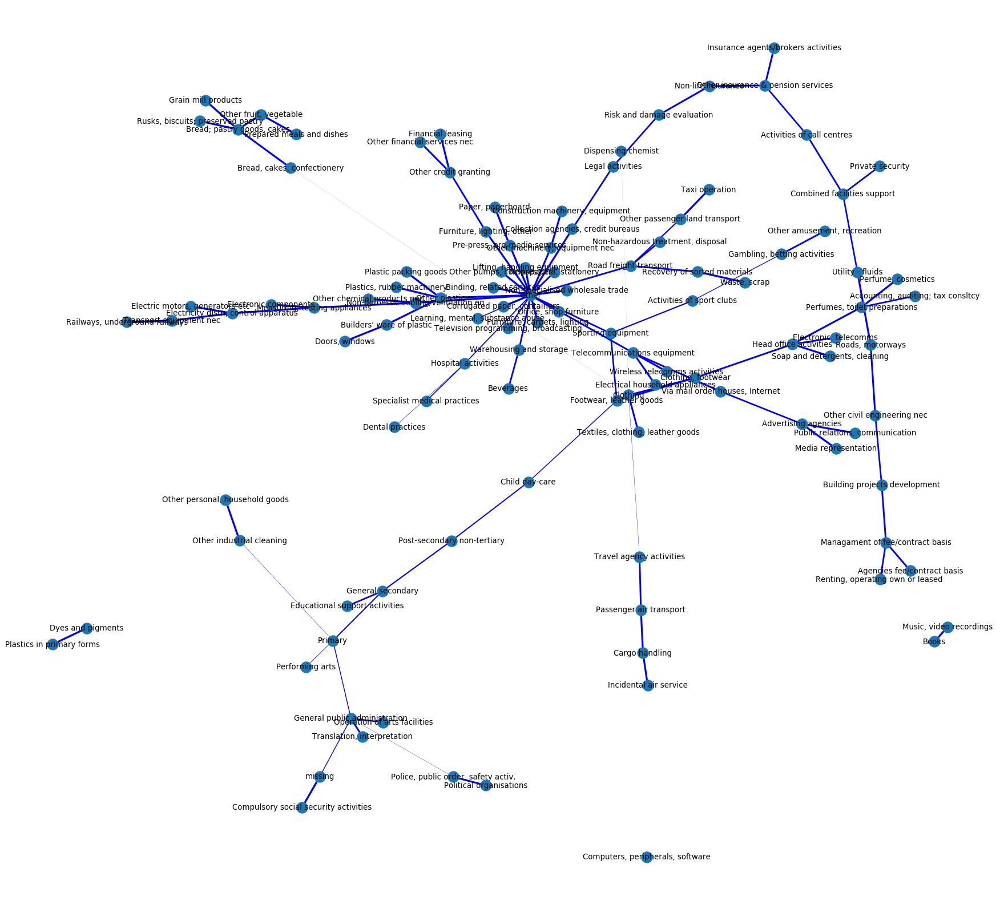

In [8]:

elarge = [(u, v) for (u, v, d) in network_largest_2008_2018_max_span_tree_manchester.edges(data=True) if d['weight'] > 0.0]


fig=plt.figure(figsize=(28, 26), dpi= 80, facecolor='w', edgecolor='k')

pos = nx.spring_layout(network_largest_2008_2018_max_span_tree_manchester)
nx.draw_networkx_nodes(network_largest_2008_2018_max_span_tree_manchester,pos=pos)
nx.draw_networkx_labels(network_largest_2008_2018_max_span_tree_manchester, pos=pos)
nx.draw_networkx_edges(network_largest_2008_2018_max_span_tree_manchester,pos=pos,width=weights_manchester,edgelist=elarge,edge_color = 'blue')
plt.savefig("../img/Manchester_only.png")


plt.axis('off')
plt.show()

In [9]:
network_largest_2009_2018_nx= build_networx_network(result_final,'weight')

network_largest_2008_2018_max_span_tree = nx.maximum_spanning_tree(network_largest_2009_2018_nx)
weights = [10*network_largest_2008_2018_max_span_tree[u][v]['weight'] for u,v in network_largest_2008_2018_max_span_tree.edges()]
weights_manchester = [10*network_largest_2008_2018_max_span_tree_manchester[u][v]['weight'] for u,v in network_largest_2008_2018_max_span_tree_manchester.edges()]

color = ['red' for u,v in network_largest_2008_2018_max_span_tree.edges()]


In [10]:
network_largest_2008_2018_max_span_tree = [network_largest_2008_2018_max_span_tree.subgraph(c) for c in nx.connected_components(network_largest_2008_2018_max_span_tree)][0]

elarge = [(u, v) for (u, v, d) in network_largest_2008_2018_max_span_tree.edges(data=True) if d['weight'] > 0.0]
eman = [(u, v) for (u, v, d) in network_largest_2008_2018_max_span_tree_manchester.edges(data=True) if d['weight'] > 0.0]

elarge_node = [u for u in network_largest_2008_2018_max_span_tree.nodes() ]
eman_node = [u for u in network_largest_2008_2018_max_span_tree_manchester.nodes()]

e_not_man = set(elarge_node) - set(eman_node)

labels_manchester = {k:k for k in e_not_man}    


fig=plt.figure(figsize=(300, 300), dpi= 50, facecolor='w', edgecolor='k')

pos = nx.nx_agraph.graphviz_layout(network_largest_2008_2018_max_span_tree,prog='sfdp')

nx.draw_networkx_nodes(network_largest_2008_2018_max_span_tree,pos=pos,node_size=2200)


nx.draw_networkx_edges(network_largest_2008_2018_max_span_tree,pos=pos,width=weights,edgelist=elarge,edge_color = 'blue')
nx.draw_networkx_nodes(network_largest_2008_2018_max_span_tree_manchester,pos=pos,width=weights_manchester,edgelist=eman,node_color = 'red',node_size=2200)
nx.draw_networkx_edges(network_largest_2008_2018_max_span_tree_manchester,pos=pos,width=weights_manchester,edgelist=eman,edge_color = 'red')

nx.draw_networkx_labels(network_largest_2008_2018_max_span_tree_manchester, pos=pos,font_size=60,font_color='red')
nx.draw_networkx_labels(network_largest_2008_2018_max_span_tree,pos, labels_manchester,nodelist=e_not_man,font_size=50,font_color='grey')

plt.axis('off')
#plt.show()
plt.savefig("../img/Manchester_UK_study_MST.png")



/usr/local/anaconda3/envs/kflows/lib/python3.7/site-packages/pygraphviz/agraph.py:1341: RuntimeWarning: Error: remove_overlap: Graphviz not built with triangulation library

  warnings.warn(b"".join(errors).decode(self.encoding), RuntimeWarning)


In [11]:
weights = [5*network_largest_2009_2018_nx[u][v]['weight'] for u,v in network_largest_2009_2018_nx.edges()]
weights_manchester = [5*network_largest_2009_2018_nx_manchester[u][v]['weight'] for u,v in network_largest_2009_2018_nx_manchester.edges()]


network_largest_2009_2018_nx = [network_largest_2009_2018_nx.subgraph(c) for c in nx.connected_components(network_largest_2008_2018_max_span_tree)][0]

elarge = [(u, v) for (u, v, d) in network_largest_2009_2018_nx.edges(data=True) if d['weight'] > 0.5]
eman = [(u, v) for (u, v, d) in network_largest_2009_2018_nx_manchester.edges(data=True) if d['weight'] > 0.5]

elarge_node = [u for u in network_largest_2009_2018_nx.nodes() ]
eman_node = [u for u in network_largest_2009_2018_nx_manchester.nodes()]

e_not_man = set(elarge_node) - set(eman_node)

labels_manchester = {k:k for k in e_not_man}    


fig=plt.figure(figsize=(300, 300), dpi= 50, facecolor='w', edgecolor='k')

pos = nx.spring_layout(network_largest_2009_2018_nx)
pos = nx.nx_agraph.graphviz_layout(network_largest_2009_2018_nx,prog='neato')

nx.draw_networkx_nodes(network_largest_2009_2018_nx,pos=pos,node_size=5200)


nx.draw_networkx_edges(network_largest_2009_2018_nx,pos=pos,width=weights,edgelist=elarge,edge_color = 'blue')
nx.draw_networkx_nodes(network_largest_2009_2018_nx_manchester,pos=pos,width=weights_manchester,edgelist=eman,node_color = 'red',node_size=5200)
nx.draw_networkx_edges(network_largest_2009_2018_nx_manchester,pos=pos,width=weights_manchester,edgelist=eman,edge_color = 'red')

nx.draw_networkx_labels(network_largest_2009_2018_nx_manchester, pos=pos,font_size=80,font_color='red')
nx.draw_networkx_labels(network_largest_2009_2018_nx,pos, labels_manchester,nodelist=e_not_man,font_size=60,font_color='grey')

plt.axis('off')
#plt.show()
plt.savefig("../img/Manchester_UK_study.png")


In [12]:
network_largest_2008_2018_max_span_tree = [network_largest_2008_2018_max_span_tree.subgraph(c) for c in nx.connected_components(network_largest_2008_2018_max_span_tree)][0]
weights = [5*network_largest_2008_2018_max_span_tree[u][v]['weight'] for u,v in network_largest_2008_2018_max_span_tree.edges()]
weights_manchester = [5*network_largest_2008_2018_max_span_tree_manchester[u][v]['weight'] for u,v in network_largest_2008_2018_max_span_tree_manchester.edges()]

elarge = [(u, v) for (u, v, d) in network_largest_2008_2018_max_span_tree.edges(data=True) if d['weight'] > 0.0]
eman = [(u, v) for (u, v, d) in network_largest_2008_2018_max_span_tree_manchester.edges(data=True) if d['weight'] > 0.0]

elarge_node = [u for u in network_largest_2008_2018_max_span_tree.nodes() ]
eman_node = [u for u in network_largest_2008_2018_max_span_tree_manchester.nodes()]

e_not_man = set(elarge_node) - set(eman_node)

labels_manchester = {k:k for k in e_not_man}    


fig=plt.figure(figsize=(300, 300), dpi= 50, facecolor='w', edgecolor='k')

pos = nx.nx_agraph.graphviz_layout(network_largest_2008_2018_max_span_tree,prog='sfdp')

nx.draw_networkx_nodes(network_largest_2008_2018_max_span_tree,pos=pos,node_size=2200)


nx.draw_networkx_edges(network_largest_2008_2018_max_span_tree,pos=pos,width=weights,edgelist=elarge,edge_color = 'blue')
nx.draw_networkx_nodes(network_largest_2008_2018_max_span_tree_manchester,pos=pos,width=weights_manchester,edgelist=eman,node_color = 'red',node_size=2200)

nx.draw_networkx_labels(network_largest_2008_2018_max_span_tree_manchester, pos=pos,font_size=60,font_color='red')
nx.draw_networkx_labels(network_largest_2008_2018_max_span_tree,pos, labels_manchester,nodelist=e_not_man,font_size=50,font_color='grey')

plt.axis('off')
#plt.show()
plt.savefig("../img/Manchester_UK_study_MST_noEdges.png")

